In [1]:
from pathlib import Path

import numba as nb
import numpy as np
import scipy.stats as stats

from natsort import natsorted

import matplotlib.pyplot as plt


plt.style.use("mike")
import warnings
warnings.simplefilter("ignore")


import astropy.units as u

import cmasher as cmr

green = "#33FF86"
purple = "#CE33FF"


import cmdstanpy
import arviz as av

%matplotlib widget


In [103]:
stan_file = "ncsn.stan"

model = cmdstanpy.CmdStanModel(
            stan_file=stan_file, model_name="ncsn",
    
    #cpp_options=cpp_options
        )

INFO:cmdstanpy:compiling stan program, exe file: /Users/jburgess/Documents/scratch/ncsn
INFO:cmdstanpy:compiler options: stanc_options={}, cpp_options={}
INFO:cmdstanpy:compiled model file: /Users/jburgess/Documents/scratch/ncsn


In [127]:
alpha = -3.
mu = 0
tau = 1.

sig = 0.1


size = 10



xl = []
x = []

for i in range(size):
    
    x_latent = stats.skewnorm.rvs(a= alpha, loc=mu, scale=tau)
    
    x_obs = x_latent + np.random.normal(0, sig)
    
    
    xl.append(x_latent)
    x.append(x_obs)
    
    

data = dict(N=size, x=x, sigx=sig)


(array([1., 0., 1., 0., 0., 1., 0., 0., 1., 0., 0., 0., 1., 1., 0., 0., 2.,
        0., 0., 0., 0., 0., 0., 1., 1.]),
 array([-1.72988807e+00, -1.64745041e+00, -1.56501276e+00, -1.48257511e+00,
        -1.40013745e+00, -1.31769980e+00, -1.23526214e+00, -1.15282449e+00,
        -1.07038684e+00, -9.87949181e-01, -9.05511527e-01, -8.23073872e-01,
        -7.40636218e-01, -6.58198564e-01, -5.75760910e-01, -4.93323256e-01,
        -4.10885601e-01, -3.28447947e-01, -2.46010293e-01, -1.63572639e-01,
        -8.11349845e-02,  1.30266973e-03,  8.37403239e-02,  1.66177978e-01,
         2.48615632e-01,  3.31053287e-01]),
 <BarContainer object of 25 artists>)

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
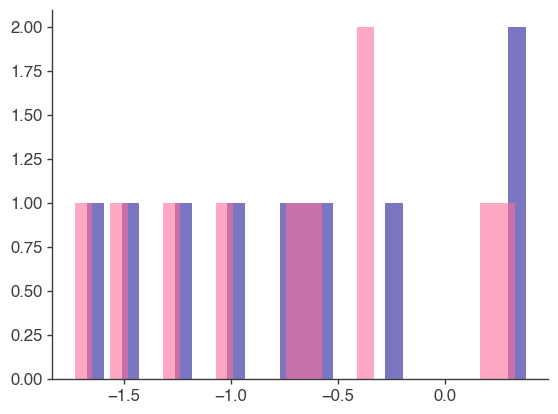

In [128]:
fig, ax = plt.subplots()


ax.hist(x)

ax.hist(xl)

In [129]:
fit = model.sample(data=data, iter_sampling=4000, iter_warmup=1000, show_progress='notebook',seed=1234)
res = av.from_cmdstanpy(fit)

res.sample_stats.tree_depth.max()

Chain 1 - warmup:   0%|          | 0/1 [00:00<?, ?it/s]

Chain 2 - warmup:   0%|          | 0/1 [00:00<?, ?it/s]

Chain 3 - warmup:   0%|          | 0/1 [00:00<?, ?it/s]

Chain 4 - warmup:   0%|          | 0/1 [00:00<?, ?it/s]

<xarray.DataArray 'tree_depth' ()>
array(7)

<xarray.DataArray 'tree_depth' ()>
array(6)

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
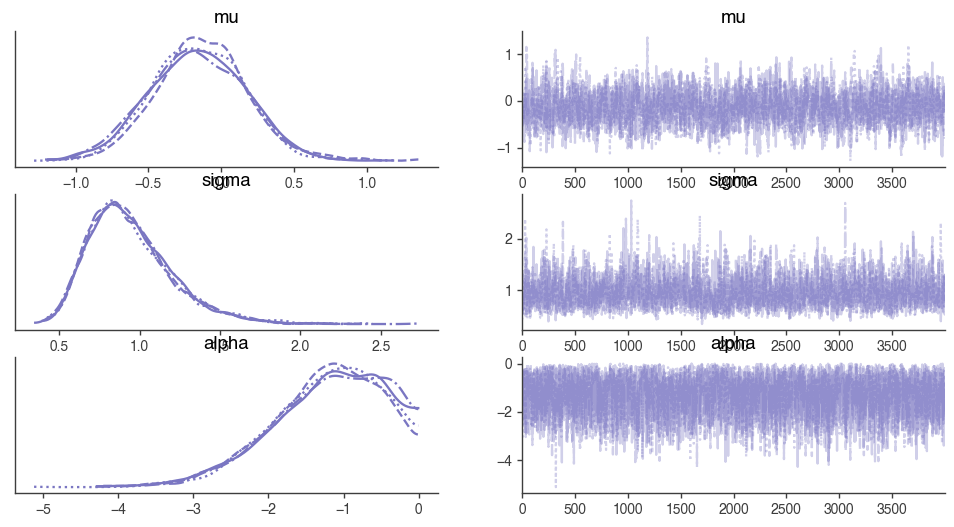

In [130]:
av.plot_trace(res, var_names=["mu","sigma", "alpha"]);

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
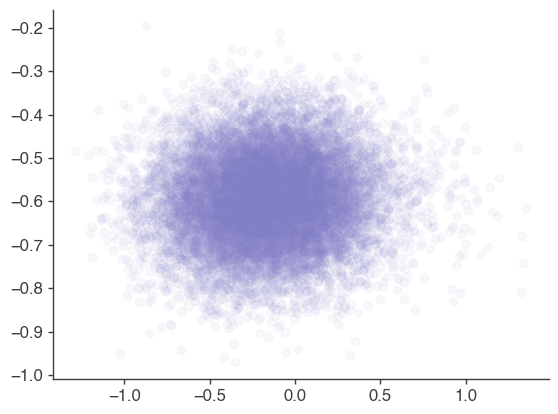

In [132]:
fig, ax = plt.subplots()


id = 5

div = res.sample_stats.diverging.stack(sample=("chain", "draw")).values


m = res.posterior.mu.stack(sample=("chain", "draw")).values

y = res.posterior.y.stack(sample=("chain", "draw")).values[id]



ax.scatter(m, y, alpha=0.05)



ax.scatter(m[div], y[div], alpha=1)

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
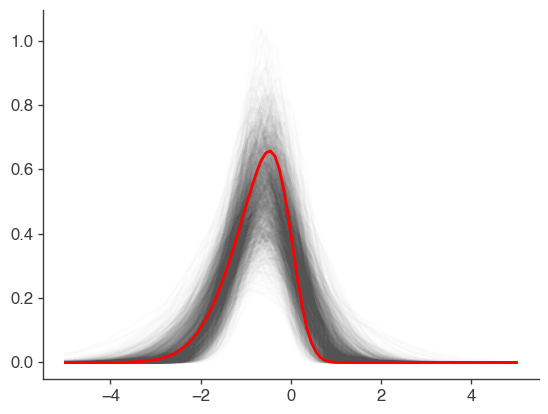

In [133]:
thin = 10

mm = res.posterior.mu.stack(sample=("chain", "draw")).values[::thin]
aa = res.posterior.alpha.stack(sample=("chain", "draw")).values[::thin]
tt = res.posterior.sigma.stack(sample=("chain", "draw")).values[::thin]



fig, ax = plt.subplots()



grid = np.linspace(-5,5, 100)

for m,t,a in zip(mm, tt, aa):
    
    
    
    ax.plot(grid, stats.skewnorm.pdf(grid, a=a, loc=m, scale=t), alpha=0.01, color='k' )
    
    
ax.plot(grid, stats.skewnorm.pdf(grid, a=alpha, loc=mu, scale=tau), alpha=1, color='r' )   
    

